# Resonance Frequency of Soil

In [1]:
import os
import sys
sys.path.append('../src')
import cv2
import h5py
import math
import time
import matplotlib
import numpy as np
import pandas as pd

from obspy import UTCDateTime
from datetime import datetime
from datetime import timedelta
from functools import partial
from scipy.signal import butter
from scipy.signal import detrend
from scipy.signal import decimate
from scipy.signal import filtfilt
from scipy.signal import spectrogram
import scipy.ndimage
from multiprocessing import Pool
from matplotlib import pyplot as plt
from das_util import read_decimate, get_tstamp, calc_NFFT
from das_util import next_power_of_2


%matplotlib inline
matplotlib.rcParams.update({'font.size': 16})


In [2]:
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

In [3]:
def fk_filter_2cones(vsp, w1=0, w2=0, cone1=False, cone2=False):
    n1, n2 = vsp.shape
    nf = next_power_of_2(n1)
    nk = next_power_of_2(n2)

    nf2=int(nf/2)
    nk2=int(nk/2)
    
    fk2d = np.fft.fft2(vsp, s=(nf,nk))
    fk2d = np.fft.fftshift(fk2d, axes=(-2,-1))
    
    nw1 = int(np.ceil(w1*nk))
    nw2 = int(np.ceil(w2*nf))

    mask1=np.ones((nf,nk), dtype=np.float64)
    mask2=np.ones((nf,nk), dtype=np.float64)

    if cone1:
        for j in np.arange(nk2-nw1, nk2+1):
            th1 = int((j-nk2+nw1) * nf2/nw1)

            mask1[:th1, j] = 0
            mask1[nf-th1:, j] = 0
            mask1[:th1, nk-j] = 0
            mask1[nf-th1:, nk-j] = 0

    if cone2:
        for j in np.arange(0, nk2):
            th2 = int(nf2 - (nw2/nk2)*(nk2-j))
            mask2[th2:nf-th2+1, j] = 0
            if j != 0:
                mask2[th2:nf-th2+1, nk-j] = 0


    mask = mask2*mask1
    
    filtered_2d = fk2d * mask
    # filtered_2d = scipy.ndimage.gaussian_filter(filtered_2d, sigma=1)
    tmp = np.fft.ifftshift(filtered_2d)
    output = np.fft.ifft2(tmp, s=(nk,nf), axes=(-1, -2))
    
    return output[:n1,:n2], filtered_2d, fk2d

## Step 1- Quality control of metadata

In [4]:
# %% sort the files
data_dir = '/1-fnp/petasaur/p-wd05/harper_plots'
file_list = np.array(os.listdir(data_dir))
acqu_time = np.array([get_tstamp(i) for i in file_list])

new_index = np.argsort(np.array(acqu_time)-acqu_time[0])
file_list = file_list[new_index]
acqu_time = acqu_time[new_index]
file_path = [os.path.join(data_dir,i) for i in file_list]

print('Total number of files:', len(file_path))

Total number of files: 3395


In [5]:
# %% the stable acquisition time period
list_all = np.arange(28,2468)
num_file = len(list_all)

# %% meta data
gauge_length_all = np.zeros(num_file, dtype=np.float64)
delta_space_all = np.zeros(num_file, dtype=np.float64)
num_channel_all = np.zeros(num_file, dtype=np.float64)
sample_rate_all = np.zeros(num_file, dtype=np.float64)
num_sample_all = np.zeros(num_file, dtype=np.float64)

for i,j in enumerate(list_all):
    print(i,j)
    with h5py.File(file_path[j],'r') as f:      
        gauge_length_all[i] = f['Acquisition'].attrs['GaugeLength']
        delta_space_all[i] = f['Acquisition'].attrs['SpatialSamplingInterval']
        sample_rate_all[i]  = f['Acquisition']['Raw[0]'].attrs['OutputDataRate']
        num_channel_all[i] = f['Acquisition']['Raw[0]'].attrs['NumberOfLoci']
        num_sample_all[i]  = len(f['Acquisition']['Raw[0]']['RawDataTime'][:])
        
# %% exclude files that drop samples
ind_good = np.where(num_sample_all == 120000)[0]
gauge_length_all = gauge_length_all[ind_good]
delta_space_all = delta_space_all[ind_good]
sample_rate_all = sample_rate_all[ind_good]
num_channel_all = num_channel_all[ind_good]
num_sample_all = num_sample_all[ind_good]
list_all = list_all[ind_good]

print(f'good acqusition for {len(ind_good)} minutes')

0 28
1 29
2 30
3 31
4 32
5 33
6 34
7 35
8 36
9 37
10 38
11 39
12 40
13 41
14 42
15 43
16 44
17 45
18 46
19 47
20 48
21 49
22 50
23 51
24 52
25 53
26 54
27 55
28 56
29 57
30 58
31 59
32 60
33 61
34 62
35 63
36 64
37 65
38 66
39 67
40 68
41 69
42 70
43 71
44 72
45 73
46 74
47 75
48 76
49 77
50 78
51 79
52 80
53 81
54 82
55 83
56 84
57 85
58 86
59 87
60 88
61 89
62 90
63 91
64 92
65 93
66 94
67 95
68 96
69 97
70 98
71 99
72 100
73 101
74 102
75 103
76 104
77 105
78 106
79 107
80 108
81 109
82 110
83 111
84 112
85 113
86 114
87 115
88 116
89 117
90 118
91 119
92 120
93 121
94 122
95 123
96 124
97 125
98 126
99 127
100 128
101 129
102 130
103 131
104 132
105 133
106 134
107 135
108 136
109 137
110 138
111 139
112 140
113 141
114 142
115 143
116 144
117 145
118 146
119 147
120 148
121 149
122 150
123 151
124 152
125 153
126 154
127 155
128 156
129 157
130 158
131 159
132 160
133 161
134 162
135 163
136 164
137 165
138 166
139 167
140 168
141 169
142 170
143 171
144 172
145 173
146 174
147 17

Text(0.5, 1.0, 'distribution of metadata')

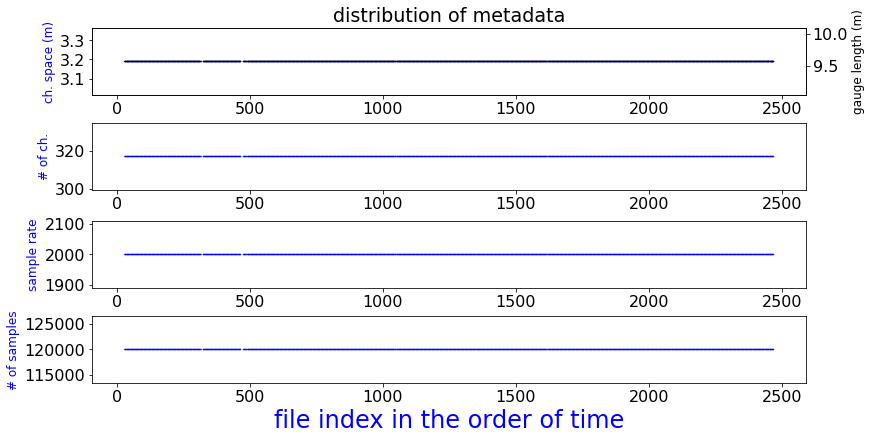

In [6]:
# %% visualize the metadata during good acqusition
plt.close('all')
fig, ax = plt.subplots(4, 1, figsize=(12, 6), constrained_layout=True)

ax[0].scatter(list_all, delta_space_all, marker='o', s=0.1, edgecolors='b')
axcopy = ax[0].twinx()
axcopy.scatter(list_all, gauge_length_all, marker='o', s=0.1, edgecolors='k')
ax[1].scatter(list_all, num_channel_all, marker='o', s=0.1, edgecolors='b')
ax[2].scatter(list_all, sample_rate_all, marker='o', s=0.1, edgecolors='b')
ax[3].scatter(list_all, num_sample_all, marker='o', s=0.1, edgecolors='b')

axcopy.set_ylabel("gauge length (m)", fontsize = 12, color='k')
ax[0].set_ylabel("ch. space (m)", fontsize = 12, color='b')
ax[1].set_ylabel("# of ch.", fontsize = 12, color='b')
ax[2].set_ylabel("sample rate", fontsize = 12, color='b')
ax[3].set_ylabel("# of samples", fontsize = 12, color='b')
ax[3].set_xlabel("file index in the order of time", fontsize = 24, color='b')
ax[0].set_title('distribution of metadata')

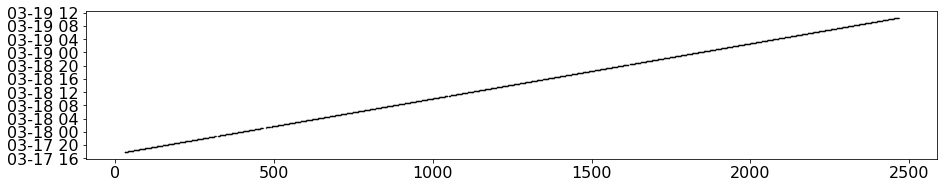

In [7]:
# %% See if the acquisition time is continuous
file_list = file_list[list_all]
acqu_time = acqu_time[list_all]
file_path = [os.path.join(data_dir,i) for i in file_list]
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(13, 2.5), constrained_layout=True)
ax.scatter(list_all, acqu_time.astype('datetime64[m]'), marker='o', s=0.1, edgecolors='k')

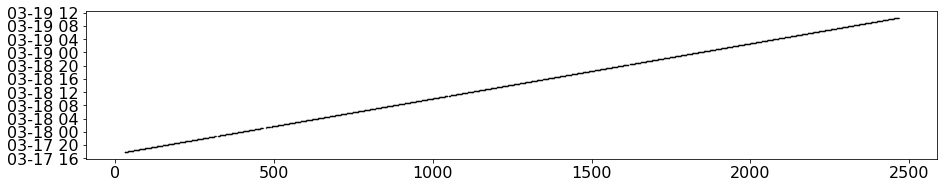

In [8]:
time_stamp = np.array([i.timestamp for i in acqu_time])
time_save = np.array([UTCDateTime(i) for i in time_stamp])

plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(13, 2.5), constrained_layout=True)
ax.scatter(list_all, time_save.astype('datetime64[m]'), marker='o', s=0.1, edgecolors='k')

## Step 2- Spectrograms

### Select: 0-36 hours | Channel 44-94 (SW buried segment)

In [18]:
start_ch, end_ch = 44, 94            # channel range
ch_id = 49                           # choose a channel to visualize
start_minutes = 230                    # starting file indice for reading
num_minutes = 50                   # number of semi-continuous 1-min files to merge
num_seconds = int(num_minutes * 60)  # total duration (s) of merged time series
dsamp_factor = 20                  # downsample rate when reading raw time series
sample_rate = int(2000 / dsamp_factor)    # final sample rate after downsampling
shift_min = 7                        # shift in minutes of the first tick when ploting
shift_sec = int(shift_min * 60)      # shift in seconds
file_inc = 360                       # plot ticks for every {file_inc} 1-min files 
time_inc = int(file_inc * 60)        # tick interval in seconds
delta_space = 3.1904762684013206

### (Don't run) The next 3 cells read the data, slowly

In [25]:
# %% read the raw data file
# %% could be the most time-consuming
# %% Do Not run this cell after the FIRST time
# %% instead, run the next cell 
since = time.time()

# %% multi-process to read and decimate lots of files 
num_proc = 20   # number of threads (too large number kills the memory) 
partial_func = partial(read_decimate, dsamp_factor=dsamp_factor, start_ch=start_ch, end_ch=end_ch)
with Pool(processes=num_proc) as pool:   # pool is closed automatically and join as a list
    print("# threads: ", num_proc)
    full_time = pool.map(partial_func, file_path[start_minutes:start_minutes+num_minutes])

# %% concatenate the list elements in time
full_time_data = np.concatenate(full_time, axis=1)

print(f'time used: {time.time()- since:.1f}')
print(f'final shape: {full_time_data.shape}')
print(f'sample rate: {sample_rate:.0f}')

# %% save it to HDF5 for future use
# datah5 = '/fd1/QibinShi_data/England_farm/farmDAS_harper_0_24hr.hdf5'
datah5 = '/fd1/QibinShi_data/England_farm/farmDAS_harper_50mins.hdf5'
with h5py.File(datah5, 'w') as f:
    f.create_dataset("data", data=full_time_data)
    f.create_dataset("timestamp", data=time_stamp)
    f.create_dataset("dt", data=sample_rate)

# threads:  20
time used: 68.5
final shape: (50, 1200000)
sample rate: 400


In [10]:
# %% Run this cell only after the FIRST time
# %% read from the saved HDF5
datah5 = '/fd1/QibinShi_data/England_farm/farmDAS_harper_0_36hr.hdf5'
with h5py.File(datah5, 'r') as f:
    full_time_data_h5 = f["data"][:]
    sample_rate_h5 = f["dt"][()]
    time_stamp_h5 = f["timestamp"][:]
full_time_data = full_time_data_h5
sample_rate = sample_rate_h5
acqu_time = np.array([UTCDateTime(i) for i in time_stamp_h5])

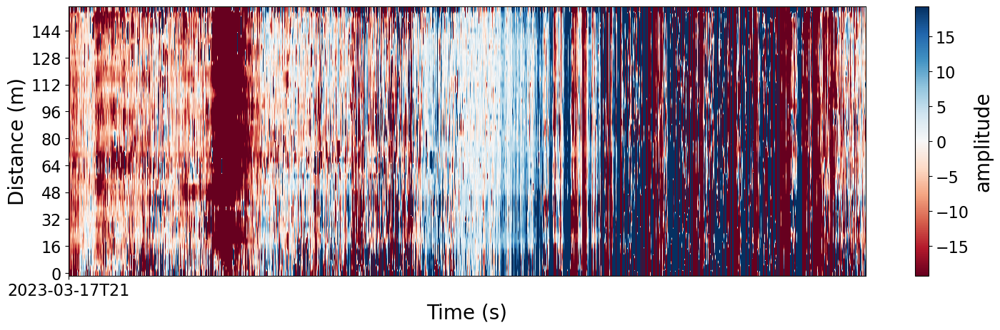

In [11]:
# %% plot data in time-space
max_amp = np.median(np.fabs(full_time_data))*2
plt.close('all')
plt.figure(figsize = (18, 5), dpi = 100)
plt.imshow(full_time_data, aspect = 'auto', cmap = 'RdBu', vmax = max_amp, vmin = -max_amp, origin='lower')
plt.ylabel("Distance (m)", fontsize = 20)
plt.xlabel("Time (s)", fontsize = 20)
plt.xticks(np.arange(0+shift_sec, num_seconds * sample_rate, time_inc*sample_rate), 
           acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[h]'))
plt.yticks(np.arange(0, end_ch-start_ch, 5), 
           np.rint(np.arange(0, delta_space*(end_ch-start_ch), 5*delta_space)).astype(int))
cbr=plt.colorbar()
cbr.set_label('amplitude', fontsize = 20)

In [12]:
# %% calculate the best NFFT for plotting
nfft, time_width = calc_NFFT(full_time_data[33], sample_rate, power_of_2=True)
print(f'saturated for period > {time_width/2} seconds')

NFFT=8192 samples, equivalent to 81.92 seconds
saturated for period > 40.96 seconds


(819, 1807) (819,) (1807,)
(2047, 1807) (2047,) (1807,)


(30.0, 40.0)

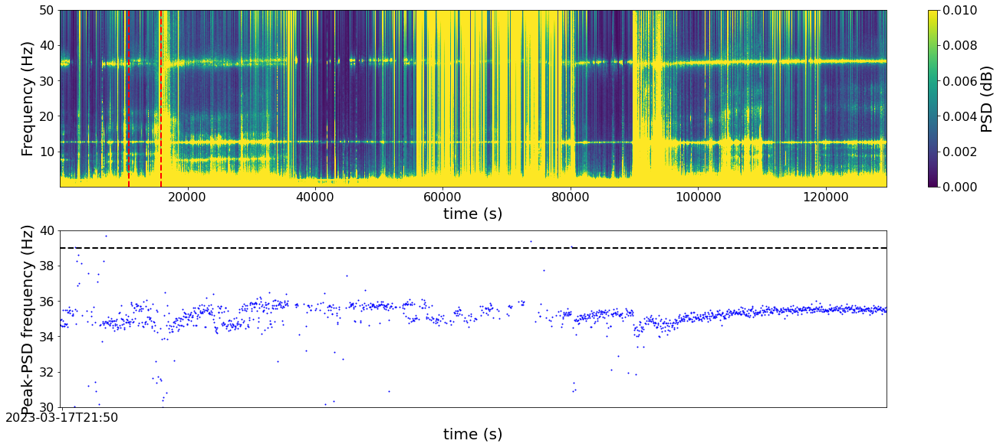

In [19]:
# %% plot data in time-frequency
plt.close('all')
fig, ax = plt.subplots(2, 1, figsize=(18, 8), constrained_layout=True)
Pxx,freqs,bins,image=ax[0].specgram(full_time_data[ch_id],Fs=sample_rate,
                                    mode='magnitude',NFFT=nfft,noverlap=int(nfft/8), 
                                    scale='linear', vmin=0, vmax=0.01)
ax[0].axvline(x=bins[220], color='r', linestyle='--', linewidth=2)
ax[0].axvline(x=bins[150], color='r', linestyle='--', linewidth=2)
# hline = ax[0].axhline(25, linestyle='--', linewidth=2, color='w') 
cbr = fig.colorbar(image, ax=ax[0])
cbr.set_label('PSD (dB)', fontsize = 20)

# ax[0].set_yscale("log")
ax[0].set_ylim(2/time_width, sample_rate/2)
ax[0].set_xlabel("time (s)", fontsize = 20)
ax[0].set_ylabel("Frequency (Hz)", fontsize = 20)

# %% set up time ticks for every 20 minutes (20 1-min files)
# ax[0].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
# ax[0].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))


# %% 1st mode resonance of every time bin
ind = np.where(np.logical_and(freqs > 15, freqs < 25))[0]
Pxx1 = Pxx[ind, :]
freqs1 = freqs[ind]
# %% 2nd mode resonance of every time bin
ind = np.where(np.logical_and(freqs > 25, freqs < 50))[0]
Pxx2 = Pxx[ind, :]
freqs2 = freqs[ind]

freq_ind1 = np.argmax(Pxx1, axis=0)
freq_ind2 = np.argmax(Pxx2, axis=0)
print(Pxx1.shape, freqs1.shape, freq_ind1.shape)
print(Pxx2.shape, freqs2.shape, freq_ind2.shape)

ax[1].scatter(bins, freqs1[freq_ind1], marker='o', s=1, edgecolors='k')
ax[1].scatter(bins, freqs2[freq_ind2], marker='o', s=1, edgecolors='b')
# ax[1].set_ylim(2/time_width, sample_rate/2)
ax[1].set_xlim(bins[0], bins[-1])
ax[1].set_xlabel("time (s)", fontsize = 20)
ax[1].set_ylabel("Peak-PSD frequency (Hz)", fontsize = 20)
ax[1].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
ax[1].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))

ax[1].axhline(39, linestyle='--', linewidth=2, color='k')
ax[1].set_ylim(30, 40)

### Denoising Spectrogram using FK and Gaussian filters

Text(0.5, 0, 'Frequency (Hz)')

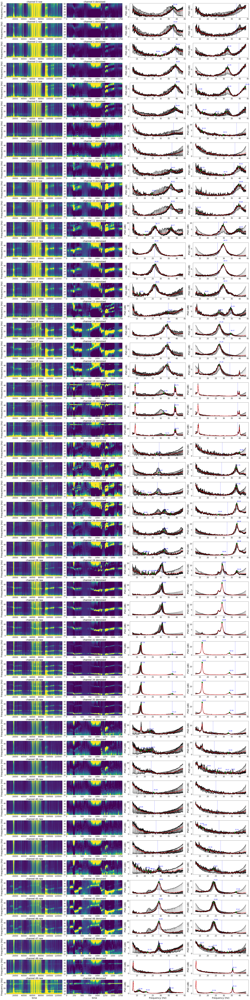

In [20]:
f0 = [37.85, 37.87, 39.48, 39.45, 39.43,
      39.42, 38.00, 37.00, 36.43, 36.32,
      36.30, 26.77, 26.05, 26.05, 26.61,
      34.69, 33.67, 33.59, 33.79, 38.71,
      38.72, 38.73, 29.00, 28.63, 27.84,
      32.40, 32.07, 32.08, 30.76, 30.80,
      30.80, 30.80, 17.59, 17.59, 17.59,
      17.59, 17.59, 24.01, 24.00, 25.00,
      26.00, 27.00, 28.00, 28.93, 28.92,
      28.69, 28.69, 28.69, 35.47, 35.62]

f0 = [37.85, 37.87, 39.48, 39.45, 39.43,
      39.42, 38.00, 37.00, 36.43, 36.32,
      36.30, 26.77, 26.05, 26.05, 26.61,
      34.69, 33.67, 33.59, 33.79, 38.71,
      38.72, 38.73, 29.00, 28.63, 27.84,
      32.40, 32.07, 32.08, 30.76, 30.80,
      30.80, 30.80, 37.15, 37.15, 37.15,
      37.15, 23.21, 24.01, 24.00, 25.00,
      26.00, 27.00, 28.00, 28.93, 28.92,
      28.69, 28.69, 28.69, 35.47, 35.62]


width=27
rel_height=0.25

# all_rf = np.zeros((end_ch-start_ch, num_seconds))

begin_f0 = np.zeros((end_ch-start_ch, 2600, 70))
end_f0 = np.zeros((end_ch-start_ch, 2600, 70))

plt.close('all')
fig, ax = plt.subplots(50, 4, figsize=(30, 120), constrained_layout=True)

for ii in np.arange(50):
    ich = ii
    Pxx, freqs, bins, image = ax[ii,0].specgram(full_time_data[ich], Fs=sample_rate,
                                    mode='magnitude',NFFT=nfft,noverlap=int(nfft/8), 
                                    scale='linear', vmin=0, vmax=0.01)

    ax[ii,0].set_ylabel("Frequency (Hz)", fontsize = 20)

    ######################
    ## Denoising
    filtered_image = Pxx[1000:3600]
    freqs1 = freqs[1000:3600]

    ##### iterations
    for i in range(4):
        filt_data, filtered_fk, fk2d = fk_filter_2cones(filtered_image.T, w1=0.001*(i+1), w2=0.005, cone1=True, cone2=False)
        image = filt_data.real.T
        image = image - np.nanmin(image)
        filtered_image = scipy.ndimage.gaussian_filter(image, sigma=i+2)

    q1=np.percentile(filtered_image, q=25)
    q2=np.percentile(filtered_image, q=99)
    ax[ii,1].imshow(filtered_image, aspect='auto', cmap='viridis', origin='lower', vmax=q2/1.5, vmin=q1)
    ax[ii,1].set_yticks(np.arange(0, 2600, 500))
    ax[ii,1].set_yticklabels(freqs1[::500].astype(int))
    ax[ii,1].set_title(f'channel {ich} denoised')
    ax[ii,0].set_title(f'channel {ich} raw')

    begin_f0[ich, :, :] = filtered_image[:, 150:220]
    end_f0[ich, :, :] = filtered_image[:, -70:]

ax[49,0].set_xlabel("time", fontsize = 20)
ax[49,1].set_xlabel("time", fontsize = 20)

begin_f0_norm = begin_f0
begin_f0_norm = begin_f0_norm - np.nanmin(begin_f0_norm, axis=1, keepdims=True)
begin_f0_norm = begin_f0_norm / np.std(begin_f0_norm, axis=1, keepdims=True) * 2

end_f0_norm = end_f0
end_f0_norm = end_f0_norm - np.nanmin(end_f0_norm, axis=1, keepdims=True)
end_f0_norm = end_f0_norm / np.std(end_f0_norm, axis=1, keepdims=True) * 2

for j in range(50):
    mean_spec = np.mean(begin_f0_norm[j], axis=1)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=0.5, width=width, rel_height=rel_height)
    for peak in peaks:
        ax[j,2].text(freqs1[peak], mean_spec[peak]+2, f'{freqs1[peak]:.2f}', fontsize=12, color='blue')

    ax[j,2].plot(freqs1, begin_f0_norm[j], color='k', linewidth=0.5)
    ax[j,2].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,2].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,2].axvline(x=f0[j], color='b', linestyle='--', linewidth=1)
    ax[j,2].set_ylabel('PSD (dB)', fontsize=20)
ax[49,2].set_xlabel('Frequency (Hz)', fontsize=20)

for j in range(50):
    mean_spec = np.mean(end_f0_norm[j], axis=1)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=0.5, width=width, rel_height=rel_height)
    for peak in peaks:
        ax[j,3].text(freqs1[peak], mean_spec[peak]+2, f'{freqs1[peak]:.2f}', fontsize=12, color='blue')

    ax[j,3].plot(freqs1, end_f0_norm[j], color='k', linewidth=0.5)
    ax[j,3].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,3].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,3].axvline(x=f0[j], color='b', linestyle='--', linewidth=1)
    ax[j,3].set_ylabel('PSD (dB)', fontsize=20)
ax[49,3].set_xlabel('Frequency (Hz)', fontsize=20)



## Experimenting with gaussian filter and peak width

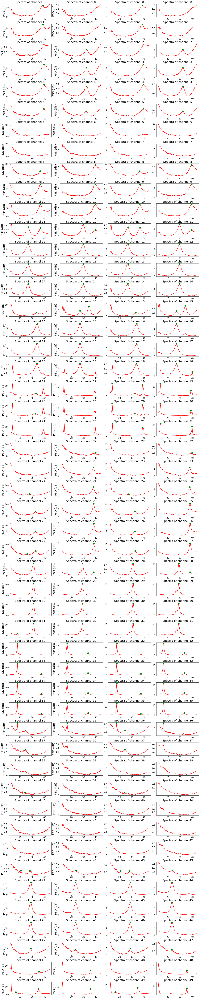

In [215]:
width=27
rel_height=0.25
prominence=1

plt.close('all')
fig, ax = plt.subplots(50, 4, figsize=(20, 100), constrained_layout=True)

for j in range(50):
    mean_spec = np.mean(begin_f0_norm[j], axis=1)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=prominence, width=width, rel_height=rel_height)

    # ax[j,0].plot(freqs1, begin_f0_norm[j], color='k', linewidth=0.5)
    ax[j,0].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,0].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,0].set_ylabel('PSD (dB)', fontsize=20)
    ax[j,0].set_title('Spectra of channel '+str(j), fontsize=20)

for j in range(50):
    mean_spec = np.mean(end_f0_norm[j], axis=1)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=prominence, width=width, rel_height=rel_height)

    # ax[j,1].plot(freqs1, end_f0_norm[j], color='k', linewidth=0.5)
    ax[j,1].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,1].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,1].set_ylabel('PSD (dB)', fontsize=20)
    ax[j,1].set_title('Spectra of channel '+str(j), fontsize=20)

for j in range(50):
    mean_spec = scipy.ndimage.gaussian_filter1d(np.mean(begin_f0_norm[j], axis=1), sigma=10, axis=0)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=prominence, width=width, rel_height=rel_height)

    # ax[j,2].plot(freqs1, begin_f0_norm[j], color='k', linewidth=0.5)
    ax[j,2].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,2].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,2].set_title('Spectra of channel '+str(j), fontsize=20)

for j in range(50):
    mean_spec = scipy.ndimage.gaussian_filter1d(np.mean(end_f0_norm[j], axis=1), sigma=10, axis=0)
    peaks, _ = scipy.signal.find_peaks(mean_spec, prominence=prominence, width=width, rel_height=rel_height)

    # ax[j,3].plot(freqs1, end_f0_norm[j], color='k', linewidth=0.5)
    ax[j,3].plot(freqs1, mean_spec, color='r', linewidth=2)

    ax[j,3].scatter(freqs1[peaks], mean_spec[peaks], color='g', s=100, zorder=5)
    ax[j,3].set_title('Spectra of channel '+str(j), fontsize=20)

## Step 3- Extract frequencies of peak Power Spectral Density (PSD)

### manually check each channel (try and modify bd&nmode)

The numbers below should be equal
# of all channels: 50
# of modes bounds: 50
# of modes counts: 50


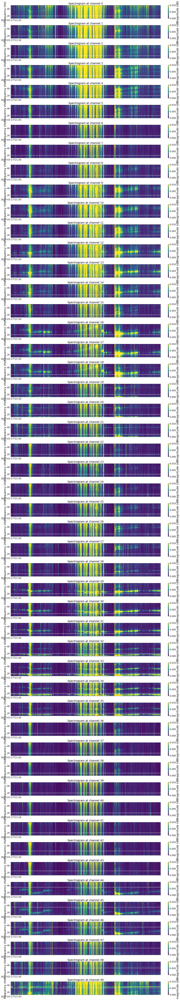

In [ ]:
########################################
### bd: boundaries between two modes ###
### nmode: 0-no, 1-1st, 2-2nd, 3-both ##
bd = [20,20,20,20,20,20,20,20,20,20,
      20,20,20,20,20,20,20,20,20,20,
      20,20,20,20,20,20,20,20,20,20,
      20,20,20,20,20,20,20,20,20,20,
      20,20,25,25,35,35,35,32,32,32]
nmode = [2,2,2,2,2,2,0,0,2,2,
         2,2,2,2,2,2,2,2,3,3,
         3,3,2,2,2,2,2,2,2,2,
         2,3,3,3,3,3,1,0,0,0,
         0,0,0,0,1,1,1,1,2,2]
#########################################
print('The numbers below should be equal')
print('# of all channels:', end_ch-start_ch)
print('# of modes bounds:', len(bd))
print('# of modes counts:', len(nmode))

plt.close('all')
fig, ax = plt.subplots((end_ch-start_ch), 1, figsize=(18, 100), constrained_layout=True)

for ich in np.arange(0,end_ch-start_ch):
    Pxx, freqs, bins, image = ax[ich].specgram(full_time_data[ich], Fs=sample_rate,
                                    mode='magnitude',NFFT=nfft,noverlap=int(nfft/8), 
                                    scale='linear', vmin=0, vmax=0.01)
    hline = ax[ich].axhline(bd[ich], linestyle='--', linewidth=2, color='w')
    ax[ich].set_ylim(13, sample_rate/2)
    ax[ich].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
    ax[ich].set_xticklabels(
        acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))
    cbr = fig.colorbar(image, ax=ax[ich])
    cbr.set_label('magnitude (dB)', fontsize = 20)
    ax[ich].set_title(f'Spectrogram at channel {ich}')
    ax[ich].set_ylabel("Frequency (Hz)", fontsize = 20)

### visualize resonance frequencies

In [27]:
#########################################
nmode = [0,0,0,0,0,0,0,0,2,2,
         2,2,2,2,2,2,2,2,3,3,
         3,3,0,2,2,2,2,2,2,2,
         2,2,3,3,3,3,1,0,0,0,
         0,0,0,0,1,1,1,0,2,2]
#########################################

# %% calculate sampling parameters for spectrogram
nfft, time_width = calc_NFFT(full_time_data[ch_id], sample_rate, power_of_2=True)
print(f'saturated for period > {time_width/2} seconds')


NFFT=8192 samples, equivalent to 81.92 seconds
saturated for period > 40.96 seconds


In [31]:
# %% get Peak frequency of all channels
dominant_freq = np.ones((int(end_ch-start_ch), 2, bins.shape[0]), dtype=np.float32) * 50
%matplotlib agg
for ich in np.arange(end_ch-start_ch):
    plt.close('all')
    Pxx, freqs, bins, image = plt.specgram(full_time_data[ich], Fs=sample_rate, 
                                           mode='psd', NFFT=nfft, noverlap=int(nfft/8))
    
    # %% 1st mode resonance of every time bin
    ind = np.where(np.logical_and(freqs > 13, freqs < bd[ich]))[0]
    Pxx1 = Pxx[ind, :]
    freqs1 = freqs[ind]
    # %% 2nd mode resonance of every time bin
    ind = np.where(np.logical_and(freqs > bd[ich], freqs < 50))[0]
    Pxx2 = Pxx[ind, :]
    freqs2 = freqs[ind]

    freq_ind1 = np.argmax(Pxx1, axis=0)
    freq_ind2 = np.argmax(Pxx2, axis=0)
    
    if nmode[ich] == 3:
        dominant_freq[ich, 0, :] = freqs1[freq_ind1]
        dominant_freq[ich, 1, :] = freqs2[freq_ind2]
    elif nmode[ich] == 2:
        dominant_freq[ich, 1, :] = freqs2[freq_ind2]
    elif nmode[ich] == 1:
        dominant_freq[ich, 0, :] = freqs1[freq_ind1]

# %% save the dominant frequency to HDF5s
with h5py.File('resonance_frequency.hdf5', 'w') as f:
    f.create_dataset("first_resonance", data=dominant_freq[:,0,:])
    f.create_dataset("second_resonance", data=dominant_freq[:,1,:])
    f.create_dataset("time", data=bins)


#### Read resonance frequency

In [32]:
with h5py.File('resonance_frequency.hdf5', 'r') as f:
    freq1 = f["first_resonance"][:]
    freq2 = f["second_resonance"][:]
    time = f["time"][:]

[Text(420, 0, '2023-03-17T21:50')]

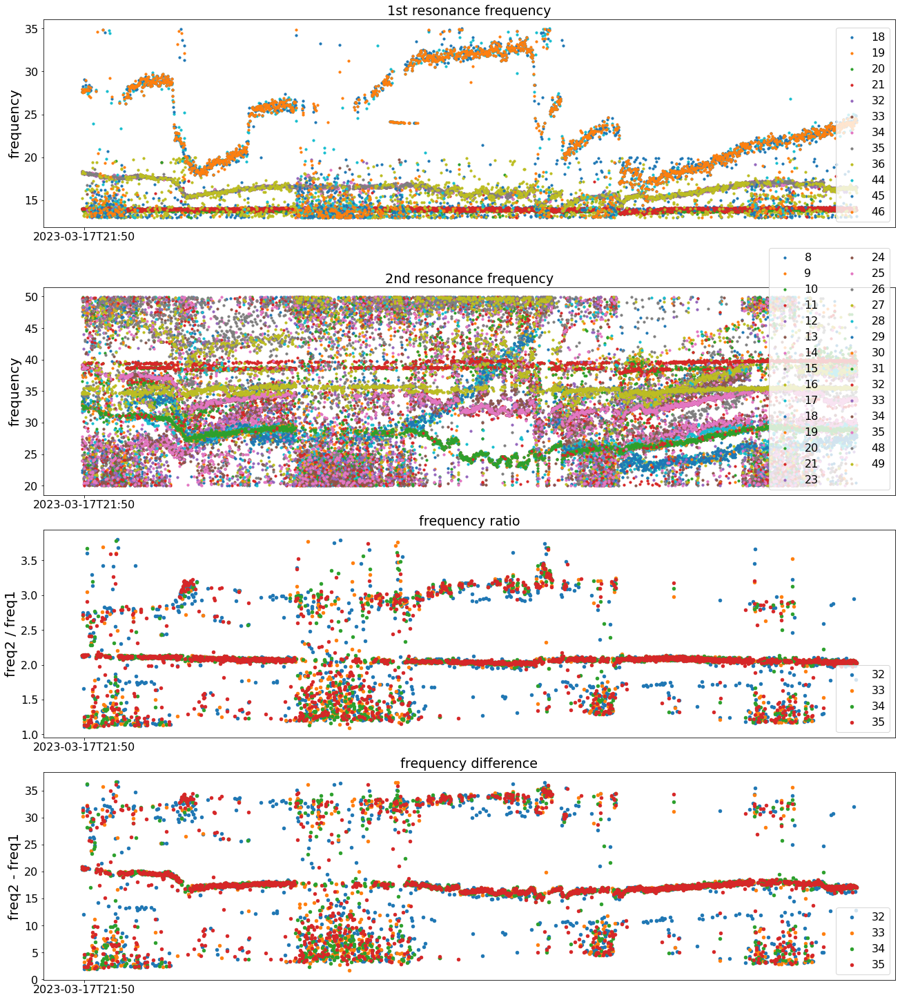

In [36]:
# %% Plotting
%matplotlib inline
matplotlib.rcParams.update({'font.size': 16})
plt.close('all')
fig, ax = plt.subplots(4, 1, figsize=(18, 20), constrained_layout=True)


# %% resonance frequency curves of selected channels
for ich in np.arange(end_ch-start_ch):
    # %% 1st reso-freq
    if nmode[ich] == 3:
        ax[0].scatter(bins, freq1[ich, :], marker='o', s=10, label=f'{ich}')
        ax[1].scatter(bins, freq2[ich, :], marker='o', s=10, label=f'{ich}')
        if ich > 30:
            ax[2].scatter(bins, freq2[ich, :]/freq1[ich, :], marker='o', s=20, label=f'{ich}')
            ax[3].scatter(bins, freq2[ich, :]-freq1[ich, :], marker='o', s=20, label=f'{ich}')
    elif nmode[ich] == 2:
        ax[1].scatter(bins, freq2[ich, :], marker='o', s=10, label=f'{ich}')
    elif nmode[ich] == 1:
        ax[0].scatter(bins, freq1[ich, :], marker='o', s=10, label=f'{ich}')

ax[0].legend(loc='lower right')
ax[0].set_ylabel("frequency", fontsize = 20)
ax[0].set_title('1st resonance frequency')
ax[0].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
ax[0].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))
ax[1].legend(loc='lower right', ncol=2)
ax[1].set_ylabel("frequency", fontsize = 20)
ax[1].set_title('2nd resonance frequency')
ax[1].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
ax[1].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))
ax[2].legend(loc='lower right')
ax[2].set_ylabel("freq2 / freq1", fontsize = 20)
ax[2].set_title('frequency ratio')
ax[2].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
ax[2].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))
ax[3].legend(loc='lower right')
ax[3].set_ylabel("freq2 - freq1", fontsize = 20)
ax[3].set_title('frequency difference')
ax[3].set_xticks(np.arange(0+shift_sec, num_seconds, time_inc))
ax[3].set_xticklabels(acqu_time[start_minutes+shift_min:start_minutes+num_minutes:file_inc].astype('datetime64[m]'))